In [109]:
# Importing Libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patheffects as path_effects

#Sweetviz report
import sweetviz as sv

# Pandas profile
from pandas_profiling import ProfileReport

# Avoid warnings
import warnings
warnings.simplefilter("ignore")

In [2]:
# Load data
data = pd.read_csv("marketing_campaign.csv",sep = '\t')

### Information about the data set

People
●	ID: Customer's unique identifier
●	Year_Birth: Customer's birth year
●	Education: Customer's education level
●	Marital_Status: Customer's marital status
●	Income: Customer's yearly household income
●	Kidhome: Number of children in customer's household
●	Teenhome: Number of teenagers in customer's household
●	Dt_Customer: Date of customer's enrollment with the company
●	Recency: Number of days since customer's last purchase
●	Complain: 1 if the customer complained in the last 2 years, 0 otherwise

Products
●	MntWines: Amount spent on wine in last 2 years
●	MntFruits: Amount spent on fruits in last 2 years
●	MntMeatProducts: Amount spent on meat in last 2 years
●	MntFishProducts: Amount spent on fish in last 2 years
●	MntSweetProducts: Amount spent on sweets in last 2 years
●	MntGoldProds: Amount spent on gold in last 2 years

Promotion
●	NumDealsPurchases: Number of purchases made with a discount
●	AcceptedCmp1: 1 if customer accepted the offer in the 1st campaign, 0 otherwise
●	AcceptedCmp2: 1 if customer accepted the offer in the 2nd campaign, 0 otherwise
●	AcceptedCmp3: 1 if customer accepted the offer in the 3rd campaign, 0 otherwise
●	AcceptedCmp4: 1 if customer accepted the offer in the 4th campaign, 0 otherwise
●	AcceptedCmp5: 1 if customer accepted the offer in the 5th campaign, 0 otherwise
●	Response: 1 if customer accepted the offer in the last campaign, 0 otherwise

Place
●	NumWebPurchases: Number of purchases made through the company’s website
●	NumCatalogPurchases: Number of purchases made using a catalogue
●	NumStorePurchases: Number of purchases made directly in stores
●	NumWebVisitsMonth: Number of visits to company’s website in the last month




### 1.EDA

In [3]:
data.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0


In [4]:
data.shape

(2240, 29)

### Pandas Profile Report:

In [5]:
pr = ProfileReport(data)
pr

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
pip install sweetviz

Note: you may need to restart the kernel to use updated packages.


In [7]:
# report by sweetviz

my_report = sv.analyze(data)
my_report.show_html()

                                             |                                             | [  0%]   00:00 ->…

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [8]:
# set up to view all the info of the columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [9]:
data.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,3,11,0


#### 1.1 Droppin the Z_CostContact and Z_Revenue columns --> as they have constant value throughout all rows

In [10]:
df = data.drop(columns= ['Z_CostContact','Z_Revenue'])

In [11]:
df.shape

(2240, 27)

In [12]:
options = ['Graduation' ,'PhD'] 
    
# selecting rows based on condition 
rslt_df = df[(df['ID'] == 4141) & 
          df['Education'].isin(options)] 
    
print('\nResult dataframe :\n',
      rslt_df)


Result dataframe :
      ID  Year_Birth   Education Marital_Status   Income  Kidhome  Teenhome  \
2  4141        1965  Graduation       Together  71613.0        0         0   

  Dt_Customer  Recency  MntWines  MntFruits  MntMeatProducts  MntFishProducts  \
2  21-08-2013       26       426         49              127              111   

   MntSweetProducts  MntGoldProds  NumDealsPurchases  NumWebPurchases  \
2                21            42                  1                8   

   NumCatalogPurchases  NumStorePurchases  NumWebVisitsMonth  AcceptedCmp3  \
2                    2                 10                  4             0   

   AcceptedCmp4  AcceptedCmp5  AcceptedCmp1  AcceptedCmp2  Complain  Response  
2             0             0             0             0         0         0  


In [13]:
def basic_info(df):
    print("This dataset has ", df.shape[1], " columns and ", df.shape[0], " rows.")
    print("This dataset has ", df[df.duplicated()].shape[0], " duplicated rows.")
    print(" ")
    print("Descriptive statistics of the numeric features in the dataset: ")
    print(" ")
    print(df.describe())
    print(" ")
    print("Information about this dataset: ")
    print(" ")
    print(df.info())

In [14]:
basic_info(df)

This dataset has  27  columns and  2240  rows.
This dataset has  0  duplicated rows.
 
Descriptive statistics of the numeric features in the dataset: 
 
                 ID   Year_Birth         Income      Kidhome     Teenhome  \
count   2240.000000  2240.000000    2216.000000  2240.000000  2240.000000   
mean    5592.159821  1968.805804   52247.251354     0.444196     0.506250   
std     3246.662198    11.984069   25173.076661     0.538398     0.544538   
min        0.000000  1893.000000    1730.000000     0.000000     0.000000   
25%     2828.250000  1959.000000   35303.000000     0.000000     0.000000   
50%     5458.500000  1970.000000   51381.500000     0.000000     0.000000   
75%     8427.750000  1977.000000   68522.000000     1.000000     1.000000   
max    11191.000000  1996.000000  666666.000000     2.000000     2.000000   

           Recency     MntWines    MntFruits  MntMeatProducts  \
count  2240.000000  2240.000000  2240.000000      2240.000000   
mean     49.109375   30

In [15]:
df.median()

ID                      5458.5
Year_Birth              1970.0
Income                 51381.5
Kidhome                    0.0
Teenhome                   0.0
Recency                   49.0
MntWines                 173.5
MntFruits                  8.0
MntMeatProducts           67.0
MntFishProducts           12.0
MntSweetProducts           8.0
MntGoldProds              24.0
NumDealsPurchases          2.0
NumWebPurchases            4.0
NumCatalogPurchases        2.0
NumStorePurchases          5.0
NumWebVisitsMonth          6.0
AcceptedCmp3               0.0
AcceptedCmp4               0.0
AcceptedCmp5               0.0
AcceptedCmp1               0.0
AcceptedCmp2               0.0
Complain                   0.0
Response                   0.0
dtype: float64

In [16]:
df_copy = df.copy()

In [17]:
# Divide the data into two dataframes: one has income values, and the other doesn't.
have_income = df_copy[df_copy.Income.isnull()== False]
missing_income = df_copy[df_copy.Income.isnull()== True]

In [18]:
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

In [19]:
# Convert the one that has income to int type
have_income.Income = have_income.Income.astype('int64')

# Give a string value of "0" to missing value, then we can convert it into int type
missing_income.Income = str(have_income.Income.median())

# Coverting String and Float dtypes to int dtype
missing_income.Income = missing_income.Income.str.replace(".5", "")
missing_income.Income = missing_income.Income.astype('int64')

In [20]:
# Combine the data
df_copy = missing_income.append(have_income)

In [21]:
options = ['Graduation' ,'PhD','2n Cycle','Master'] 
    
# selecting rows based on condition 
rslt_df = df_copy[(df_copy['ID'] == 5250) & 
          df_copy['Education'].isin(options)] 
    
print('\nResult dataframe :\n',
      rslt_df)


Result dataframe :
         ID  Year_Birth Education Marital_Status  Income  Kidhome  Teenhome  \
2084  5250        1943    Master          Widow   51381        0         0   

     Dt_Customer  Recency  MntWines  MntFruits  MntMeatProducts  \
2084  30-10-2013       75       532        126              490   

      MntFishProducts  MntSweetProducts  MntGoldProds  NumDealsPurchases  \
2084              164               126           126                  1   

      NumWebPurchases  NumCatalogPurchases  NumStorePurchases  \
2084                5                    5                 11   

      NumWebVisitsMonth  AcceptedCmp3  AcceptedCmp4  AcceptedCmp5  \
2084                  1             0             0             1   

      AcceptedCmp1  AcceptedCmp2  Complain  Response  
2084             0             0         0         1  


In [22]:
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2240 entries, 10 to 2239
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   ID                   2240 non-null   int64 
 1   Year_Birth           2240 non-null   int64 
 2   Education            2240 non-null   object
 3   Marital_Status       2240 non-null   object
 4   Income               2240 non-null   int64 
 5   Kidhome              2240 non-null   int64 
 6   Teenhome             2240 non-null   int64 
 7   Dt_Customer          2240 non-null   object
 8   Recency              2240 non-null   int64 
 9   MntWines             2240 non-null   int64 
 10  MntFruits            2240 non-null   int64 
 11  MntMeatProducts      2240 non-null   int64 
 12  MntFishProducts      2240 non-null   int64 
 13  MntSweetProducts     2240 non-null   int64 
 14  MntGoldProds         2240 non-null   int64 
 15  NumDealsPurchases    2240 non-null   int64 
 16  NumWe

#### 1.2 Issue regarding date 

In [23]:
# This function converts a scalar, array-like, Series or DataFrame/dict-like to a pandas datetime object.
df_copy.Dt_Customer = pd.to_datetime(df_copy.Dt_Customer)

In [24]:
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2240 entries, 10 to 2239
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   ID                   2240 non-null   int64         
 1   Year_Birth           2240 non-null   int64         
 2   Education            2240 non-null   object        
 3   Marital_Status       2240 non-null   object        
 4   Income               2240 non-null   int64         
 5   Kidhome              2240 non-null   int64         
 6   Teenhome             2240 non-null   int64         
 7   Dt_Customer          2240 non-null   datetime64[ns]
 8   Recency              2240 non-null   int64         
 9   MntWines             2240 non-null   int64         
 10  MntFruits            2240 non-null   int64         
 11  MntMeatProducts      2240 non-null   int64         
 12  MntFishProducts      2240 non-null   int64         
 13  MntSweetProducts     2240 non-nu

### Reset the index

In [25]:
# Reset the index
df_analysis = df_copy.reset_index(drop=True)

In [26]:
df_analysis

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response
0,1994,1983,Graduation,Married,51381,1,0,2013-11-15,11,5,5,6,0,2,1,1,1,0,2,7,0,0,0,0,0,0,0
1,5255,1986,Graduation,Single,51381,1,0,2013-02-20,19,5,1,3,3,263,362,0,27,0,0,1,0,0,0,0,0,0,0
2,7281,1959,PhD,Single,51381,0,0,2013-05-11,80,81,11,50,3,2,39,1,1,3,4,2,0,0,0,0,0,0,0
3,7244,1951,Graduation,Single,51381,2,1,2014-01-01,96,48,5,48,6,10,7,3,2,1,4,6,0,0,0,0,0,0,0
4,8557,1982,Graduation,Single,51381,1,0,2013-06-17,57,11,3,22,2,2,6,2,2,0,3,6,0,0,0,0,0,0,0
5,10629,1973,2n Cycle,Married,51381,1,0,2012-09-14,25,25,3,43,17,4,17,3,3,0,3,8,0,0,0,0,0,0,0
6,8996,1957,PhD,Married,51381,2,1,2012-11-19,4,230,42,192,49,37,53,12,7,2,8,9,0,0,0,0,0,0,0
7,9235,1957,Graduation,Single,51381,1,1,2014-05-27,45,7,0,8,2,0,1,1,1,0,2,7,0,0,0,0,0,0,0
8,5798,1973,Master,Together,51381,0,0,2013-11-23,87,445,37,359,98,28,18,1,2,4,8,1,0,0,0,0,0,0,0
9,8268,1961,PhD,Married,51381,0,1,2013-11-07,23,352,0,27,10,0,15,3,6,1,7,6,0,0,0,0,0,0,0


In [27]:
df_analysis.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   ID                   2240 non-null   int64         
 1   Year_Birth           2240 non-null   int64         
 2   Education            2240 non-null   object        
 3   Marital_Status       2240 non-null   object        
 4   Income               2240 non-null   int64         
 5   Kidhome              2240 non-null   int64         
 6   Teenhome             2240 non-null   int64         
 7   Dt_Customer          2240 non-null   datetime64[ns]
 8   Recency              2240 non-null   int64         
 9   MntWines             2240 non-null   int64         
 10  MntFruits            2240 non-null   int64         
 11  MntMeatProducts      2240 non-null   int64         
 12  MntFishProducts      2240 non-null   int64         
 13  MntSweetProducts     2240 non-nul

# 2. Visualizations

#### 2.1 Check the outliers

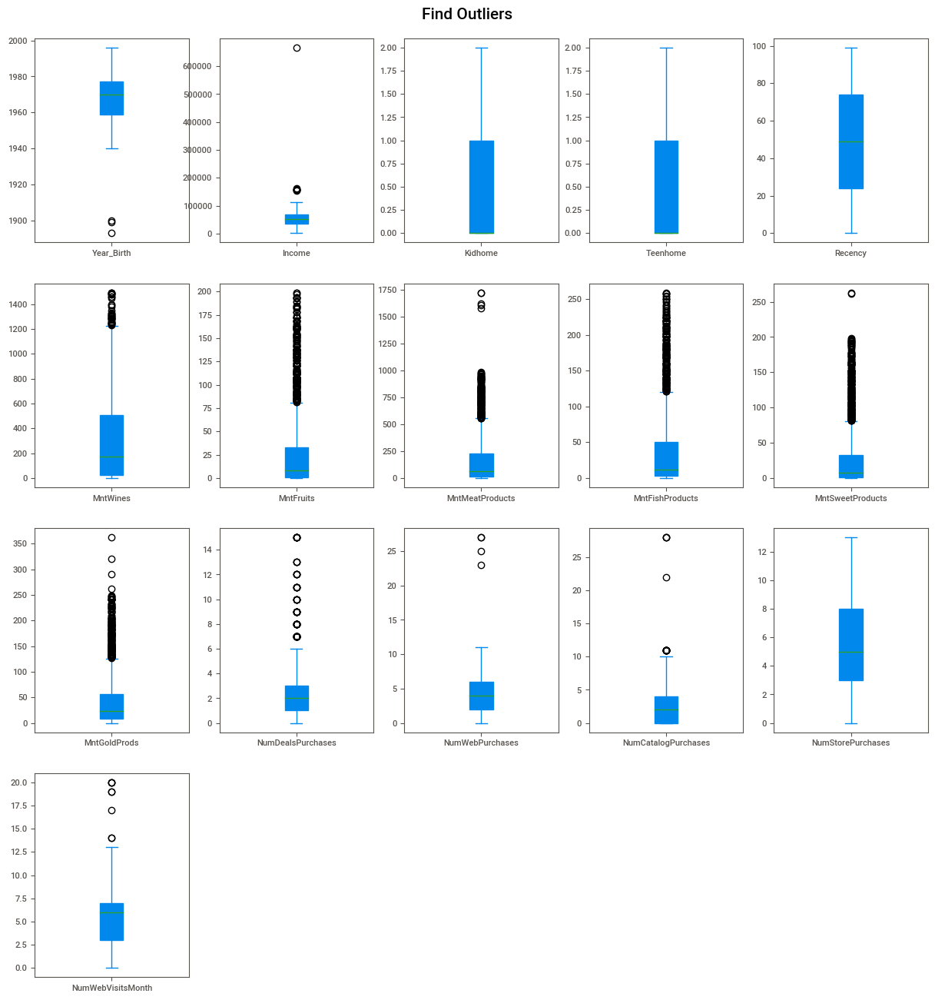

In [28]:
# select columns to plot
# Dropping the categorical columns/ un-useful columns(ID) --> to plot outliers
df_to_plot = df.drop(columns=['ID', 'AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Response', 'Complain']).select_dtypes(include=np.number)

# subplots: layout=(rows,columns) ; kind='Type of boxblot' ; patch_artist=True (To fill the boxplot with colour)
df_to_plot.plot(subplots=True, layout=(5,5), kind='box', figsize=(15,20), patch_artist=True)

plt.suptitle('Find Outliers', fontsize=15, y=0.9)
plt.savefig('boxplots.png', bbox_inches='tight')

### 2.1.1 Treating outliers (using emperical formula (µ - 3σ) )

In [29]:
df_analysis.Year_Birth.describe()

count    2240.000000
mean     1968.805804
std        11.984069
min      1893.000000
25%      1959.000000
50%      1970.000000
75%      1977.000000
max      1996.000000
Name: Year_Birth, dtype: float64

In [30]:
# Remove outliers in year_birth -->(µ - 3σ)

new_df = df_analysis[df_analysis.Year_Birth >= (df_analysis.Year_Birth.mean()-3*df_analysis.Year_Birth.std())]
new_df.Year_Birth.describe()

count    2237.000000
mean     1968.901654
std        11.701917
min      1940.000000
25%      1959.000000
50%      1970.000000
75%      1977.000000
max      1996.000000
Name: Year_Birth, dtype: float64

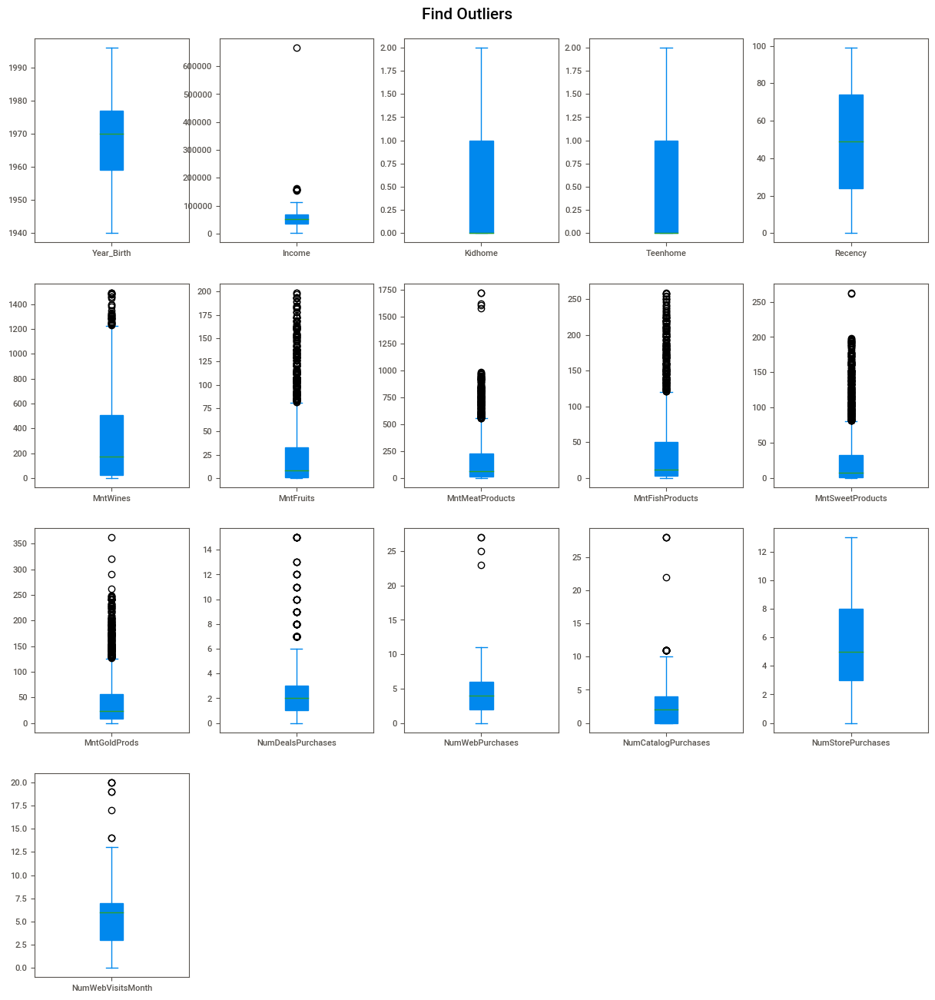

In [31]:
# select columns to plot
# Dropping the categorical columns/ un-useful columns(ID) --> to plot outliers
df_to_plot = new_df.drop(columns=['ID', 'AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Response', 'Complain']).select_dtypes(include=np.number)

# subplots: layout=(rows,columns) ; kind='Type of boxblot' ; patch_artist=True (To fill the boxplot with colour)
df_to_plot.plot(subplots=True, layout=(5,5), kind='box', figsize=(15,20), patch_artist=True)

plt.suptitle('Find Outliers', fontsize=15, y=0.9)
plt.savefig('boxplots.png', bbox_inches='tight')

####  --> we got a new range of outliers 

#### Observations : Patterns and Anomalies

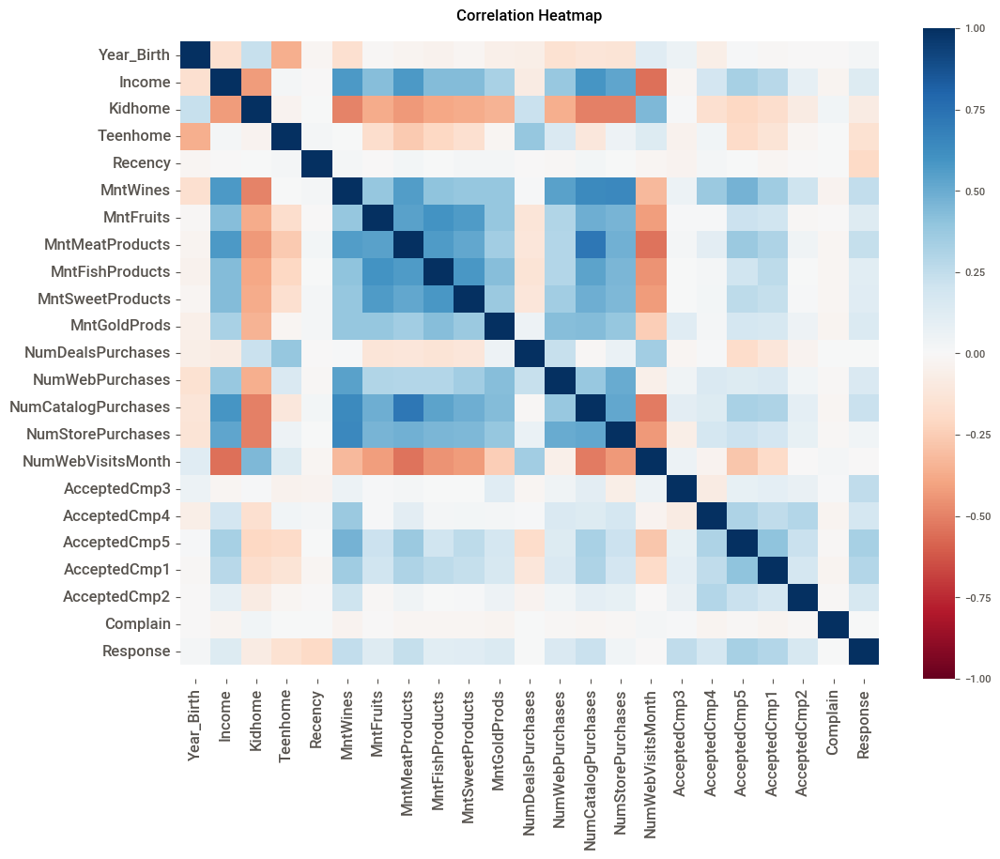

In [32]:

# select columns to plot
df_to_plot = new_df.drop(columns=['ID'])

# create heatmap
plt.figure(figsize = (12, 9))
s = sns.heatmap(df_to_plot.corr(),  cmap = 'RdBu',vmin = -1, vmax = 1,center = 0)
s.set_yticklabels(s.get_yticklabels(), rotation = 0, fontsize = 12)
s.set_xticklabels(s.get_xticklabels(), rotation = 90, fontsize = 12)
bottom, top = s.get_ylim()
s.set_ylim(bottom + 0.5, top - 0.5)
plt.title("Correlation Heatmap")
plt.savefig('heatmap.png', bbox_inches='tight')
plt.show()

#### Here blue colour indicates --> +ve co-relation
####      brown colour indicates --> -ve co-relation

<AxesSubplot:xlabel='Kidhome', ylabel='count'>

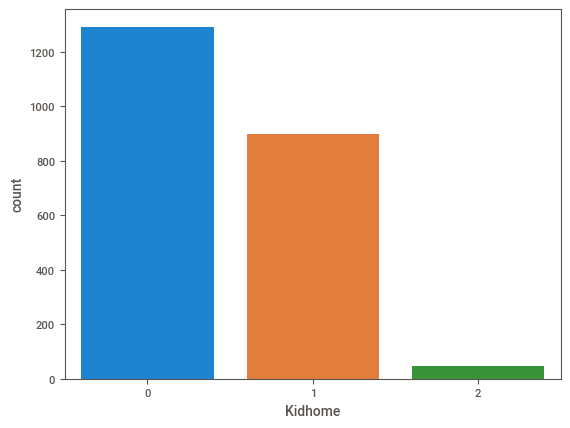

In [33]:
sns.countplot(df.Kidhome,data=df)

Adding new columns summarizing some columns --> minimizing the data 
•	Join_year       --> The year that person became a customer, which can be engineered from "Dt_Customer"
•	Join_month      --> The month that person became a customer, which can be engineered from "Dt_Customer"
•	Join_weekday    -->The day of the week that person became a customer, which can be engineered from "Dt_Customer"
•	Minorhome       --> The total amount of minors in their family, which can be acquired by summing up by Kidhome and                                 Teenhome.
•	Total_Mnt       --> Total amount spent in the last two years, which can be acquired by summing up all the "Mnt"-related                             columns
•	Total_num_purchase--> Total number of purchases in the last two years, which can be acquired by summing up all the "Num"-                            related columns
•	Total_accept     --> Total amount a customer accepted the offer in marketing campaign, which can be acquired by summing up                          all the "Accepted"-related columns and the "Response" column
•	"AOV"             --> AOV stands for the average order volume of each customer, which can be engineered by dividing                                  Total_Mnt by Total_num_purchase


In [34]:
# Create new features

new_df["Join_year"] = new_df.Dt_Customer.dt.year
new_df["Join_month"] = new_df.Dt_Customer.dt.month
new_df["Join_weekday"] = new_df.Dt_Customer.dt.weekday
new_df["Minorhome"] = new_df.Kidhome + new_df.Teenhome
new_df['Total_Spent'] = new_df.MntWines+ new_df.MntFruits+ new_df.MntMeatProducts+ new_df.MntFishProducts+ new_df.MntSweetProducts+ new_df.MntGoldProds 
new_df['Total_num_purchase'] = new_df.NumDealsPurchases+ new_df.NumWebPurchases+ new_df.NumCatalogPurchases+ new_df.NumStorePurchases+ new_df.NumWebVisitsMonth 
new_df['Total_accept'] = new_df.AcceptedCmp1 + new_df.AcceptedCmp2 + new_df.AcceptedCmp2 + new_df.AcceptedCmp2  + new_df.AcceptedCmp3 + new_df.AcceptedCmp4 + new_df.AcceptedCmp5 + new_df.Response
new_df['AOV'] = new_df.Total_Spent/new_df.Total_num_purchase

In [35]:
new_df.sample(6)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Join_year,Join_month,Join_weekday,Minorhome,Total_Spent,Total_num_purchase,Total_accept,AOV
1299,9010,1972,Master,Married,83151,0,0,2013-10-02,80,968,147,842,137,42,210,1,5,7,10,2,1,0,1,1,0,0,1,2013,10,2,0,2346,25,4,93.840000
1847,9576,1982,PhD,Together,32313,1,0,2013-11-02,60,86,4,56,2,4,7,3,4,0,4,9,0,0,0,0,0,0,0,2013,11,5,1,159,20,0,7.950000
1086,6421,1961,Graduation,Together,88347,0,0,2013-03-07,32,1050,178,555,77,138,118,1,4,7,9,1,0,0,0,1,0,0,0,2013,3,3,0,2116,22,1,96.181818
1985,9289,1979,Graduation,Married,36781,1,0,2014-10-04,16,29,1,17,0,3,13,1,2,1,2,8,0,0,0,0,0,0,1,2014,10,5,1,63,14,1,4.500000
362,175,1986,Graduation,Married,71952,1,0,2013-10-01,93,656,80,455,52,107,93,2,8,4,8,4,1,0,1,0,0,0,0,2013,10,1,1,1443,26,2,55.500000
1672,6437,1985,2n Cycle,Single,41473,1,0,2013-06-19,80,21,8,20,15,3,9,1,2,0,3,7,0,0,0,0,0,0,0,2013,6,2,1,76,13,0,5.846154


In [36]:
new_df['Marital_Status']=new_df['Marital_Status'].replace({'Divorced':'Alone','Single':'Alone','Married':'Couple','Together':'Couple','Absurd':'Alone','Widow':'Alone','YOLO':'Alone'})

In [37]:
new_df

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Join_year,Join_month,Join_weekday,Minorhome,Total_Spent,Total_num_purchase,Total_accept,AOV
0,1994,1983,Graduation,Couple,51381,1,0,2013-11-15,11,5,5,6,0,2,1,1,1,0,2,7,0,0,0,0,0,0,0,2013,11,4,1,19,11,0,1.727273
1,5255,1986,Graduation,Alone,51381,1,0,2013-02-20,19,5,1,3,3,263,362,0,27,0,0,1,0,0,0,0,0,0,0,2013,2,2,1,637,28,0,22.750000
2,7281,1959,PhD,Alone,51381,0,0,2013-05-11,80,81,11,50,3,2,39,1,1,3,4,2,0,0,0,0,0,0,0,2013,5,5,0,186,11,0,16.909091
3,7244,1951,Graduation,Alone,51381,2,1,2014-01-01,96,48,5,48,6,10,7,3,2,1,4,6,0,0,0,0,0,0,0,2014,1,2,3,124,16,0,7.750000
4,8557,1982,Graduation,Alone,51381,1,0,2013-06-17,57,11,3,22,2,2,6,2,2,0,3,6,0,0,0,0,0,0,0,2013,6,0,1,46,13,0,3.538462
5,10629,1973,2n Cycle,Couple,51381,1,0,2012-09-14,25,25,3,43,17,4,17,3,3,0,3,8,0,0,0,0,0,0,0,2012,9,4,1,109,17,0,6.411765
6,8996,1957,PhD,Couple,51381,2,1,2012-11-19,4,230,42,192,49,37,53,12,7,2,8,9,0,0,0,0,0,0,0,2012,11,0,3,603,38,0,15.868421
7,9235,1957,Graduation,Alone,51381,1,1,2014-05-27,45,7,0,8,2,0,1,1,1,0,2,7,0,0,0,0,0,0,0,2014,5,1,2,18,11,0,1.636364
8,5798,1973,Master,Couple,51381,0,0,2013-11-23,87,445,37,359,98,28,18,1,2,4,8,1,0,0,0,0,0,0,0,2013,11,5,0,985,16,0,61.562500
9,8268,1961,PhD,Couple,51381,0,1,2013-11-07,23,352,0,27,10,0,15,3,6,1,7,6,0,0,0,0,0,0,0,2013,11,3,1,404,23,0,17.565217


#### "0,1,2,3,4,5,6" --> "Monday,Tuesday....." --> Days of the week

####  from the graph we conclude that --> maximum sale is on sunday followed by wednesday

#### from the graph we conclude that --> maximum sale is on August(211) followed by October (209) with a mere difference 
####                   .              --> and minimum sale is on july(141 )

In [38]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2237 entries, 0 to 2239
Data columns (total 35 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   ID                   2237 non-null   int64         
 1   Year_Birth           2237 non-null   int64         
 2   Education            2237 non-null   object        
 3   Marital_Status       2237 non-null   object        
 4   Income               2237 non-null   int64         
 5   Kidhome              2237 non-null   int64         
 6   Teenhome             2237 non-null   int64         
 7   Dt_Customer          2237 non-null   datetime64[ns]
 8   Recency              2237 non-null   int64         
 9   MntWines             2237 non-null   int64         
 10  MntFruits            2237 non-null   int64         
 11  MntMeatProducts      2237 non-null   int64         
 12  MntFishProducts      2237 non-null   int64         
 13  MntSweetProducts     2237 non-nul

<Figure size 3000x2000 with 0 Axes>

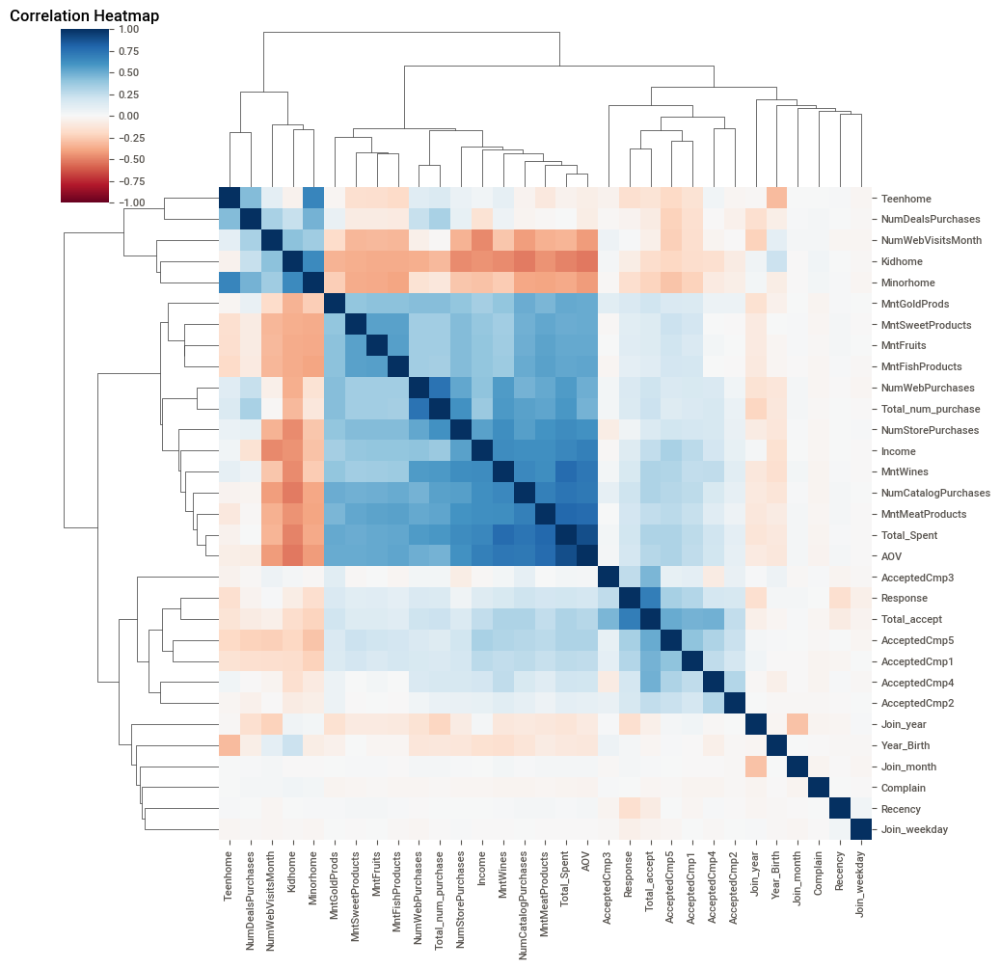

In [108]:
# select columns to plot
df_to_plot = new_df.drop(columns=['ID'])

plt.figure(figsize = (30, 20))
s = sns.clustermap(df_to_plot.corr(method = 'kendall'),  cmap = 'RdBu',vmin = -1, vmax = 1,center = 0)

plt.title("Correlation Heatmap")
plt.show()

In [41]:
datatype = new_df.dtypes

#col = datatype[(datatype == 'object') | (datatype == 'int64')| (datatype == 'float64')].index.tolist()
num_col = datatype[(datatype == 'float64') | (datatype == 'int64')].index.tolist()
cat_col = datatype[(datatype == 'object')].index.tolist()
print("Categorical Columns :",cat_col)
print("Numerical Columns :",num_col)

Categorical Columns : ['Education', 'Marital_Status']
Numerical Columns : ['ID', 'Year_Birth', 'Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts', 'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2', 'Complain', 'Response', 'Join_year', 'Join_month', 'Join_weekday', 'Minorhome', 'Total_Spent', 'Total_num_purchase', 'Total_accept', 'AOV']


### Univariate Analysis

Continuous Variable Analysis

Measure of central tendency(Mean, Median, Mode) of the variable.
Measure of spread(Range,IQR, Variance,Standard Deviation) of the variable.
Measure of Shape(Symmetrical Distribution e.g. Normal Distribution,Asymmetrical Distribution (Left or Right Skewed Distribution),Kurtosis(shape of the of the distribution in terms of height or flatness)

Categorical Variable Analysis

For categorical variables, we will use frequency distribution of each category.e.g Bar Chart, Pie Chart

In [43]:

# Run discriptive statistics of numerical datatypes.
new_df.describe(include = ['float64','int64'])

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Join_year,Join_month,Join_weekday,Minorhome,Total_Spent,Total_num_purchase,Total_accept,AOV
count,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000,2237.000000
mean,5590.726419,1968.901654,52227.402325,0.444345,0.506482,49.104604,303.995530,26.270451,166.916853,37.523022,27.068842,43.968708,2.326777,4.087170,2.662494,5.794367,5.319177,0.072865,0.074654,0.072418,0.064372,0.013411,0.008941,0.149307,2013.027716,6.518552,3.021457,0.950827,605.743406,20.189987,0.473849,inf
std,3245.118591,11.701917,25043.267011,0.538467,0.544593,28.956073,336.574382,39.715972,225.661158,54.639909,41.293949,52.054318,1.932923,2.779461,2.923456,3.250940,2.426386,0.259974,0.262890,0.259237,0.245469,0.115052,0.094152,0.356471,0.684704,3.514122,2.009700,0.752037,601.840466,7.290492,1.008843,NaN
min,0.000000,1940.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2012.000000,1.000000,0.000000,0.000000,5.000000,0.000000,0.000000,0.228571
25%,2829.000000,1959.000000,35523.000000,0.000000,0.000000,24.000000,24.000000,1.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2013.000000,3.000000,1.000000,0.000000,69.000000,14.000000,0.000000,5.000000
50%,5455.000000,1970.000000,51381.000000,0.000000,0.000000,49.000000,174.000000,8.000000,67.000000,12.000000,8.000000,24.000000,2.000000,4.000000,2.000000,5.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2013.000000,6.000000,3.000000,1.000000,396.000000,19.000000,0.000000,17.214286
75%,8427.000000,1977.000000,68281.000000,1.000000,1.000000,74.000000,504.000000,33.000000,232.000000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2013.000000,10.000000,5.000000,1.000000,1045.000000,25.000000,1.000000,39.022727
max,11191.000000,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,362.000000,15.000000,27.000000,28.000000,13.000000,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2014.000000,12.000000,6.000000,3.000000,2525.000000,46.000000,7.000000,inf


In [45]:
# Lets Analysis the Target Variable "Survived"
# Calculate the percentage of people who Survived and Not Survived
new_df["Income"].value_counts()

51381     24
7500      12
35860      4
37760      3
83844      3
48432      3
80134      3
18929      3
63841      3
18690      3
47025      3
67445      3
39922      3
34176      3
46098      3
38578      2
79146      2
75507      2
64857      2
80573      2
63381      2
45143      2
67911      2
84219      2
23331      2
34596      2
51369      2
49912      2
37070      2
71322      2
75127      2
81217      2
82032      2
22804      2
83151      2
46891      2
40049      2
37697      2
67546      2
72071      2
26490      2
75702      2
63342      2
71853      2
34600      2
34935      2
15287      2
74881      2
68695      2
62972      2
33249      2
84169      2
23228      2
26091      2
20180      2
47352      2
70924      2
56962      2
70038      2
70179      2
66835      2
28249      2
31859      2
61286      2
45759      2
24882      2
31353      2
37284      2
71367      2
74293      2
48918      2
63693      2
25509      2
68682      2
44794      2
18701      2
37717      2

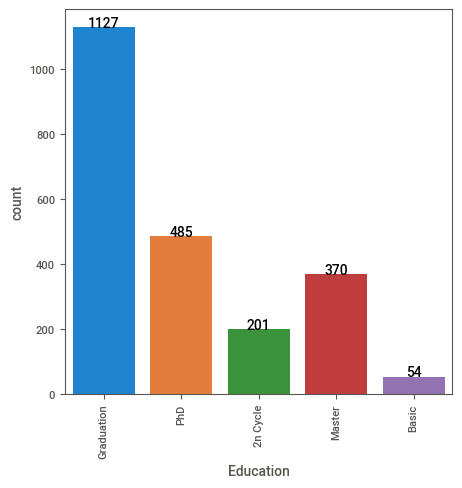

In [49]:
# Lets Display Count on top of countplot

fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Education', data=new_df)
graph.set_xticklabels(graph.get_xticklabels(),rotation=90)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

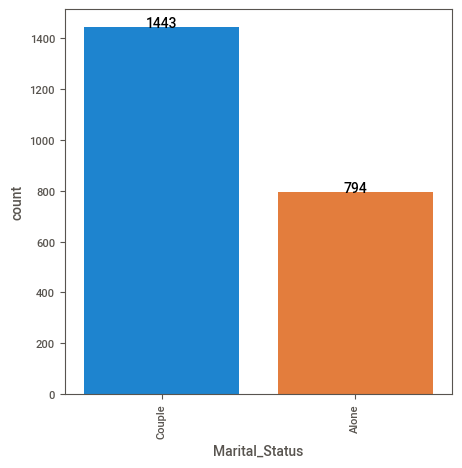

In [52]:
# Lets Display Count on top of countplot

fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Marital_Status', data=new_df)
graph.set_xticklabels(graph.get_xticklabels(),rotation=90)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

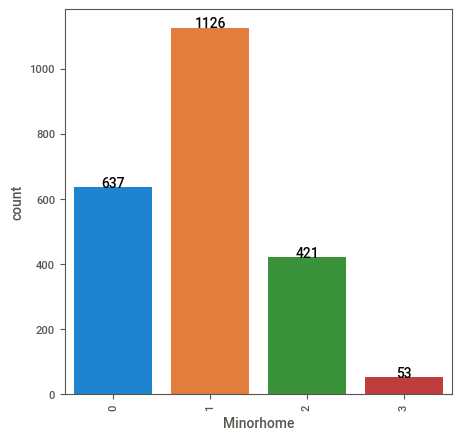

In [51]:
# Lets Display Count on top of countplot

fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Minorhome', data=new_df)
graph.set_xticklabels(graph.get_xticklabels(),rotation=90)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

In [ ]:
Join_weekday

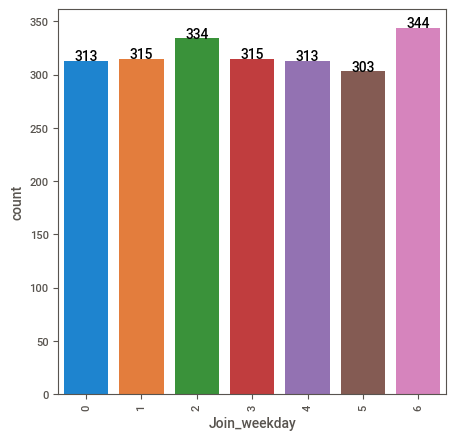

In [53]:
# Lets Display Count on top of countplot

fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Join_weekday', data=new_df)
graph.set_xticklabels(graph.get_xticklabels(),rotation=90)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

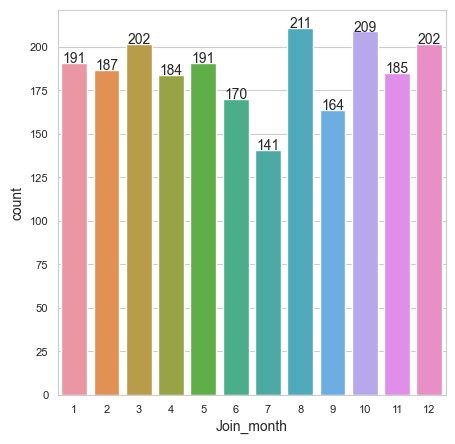

In [115]:
# Lets Display Count on top of countplot

fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Join_month', data=new_df)
graph.set_xticklabels(graph.get_xticklabels())
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

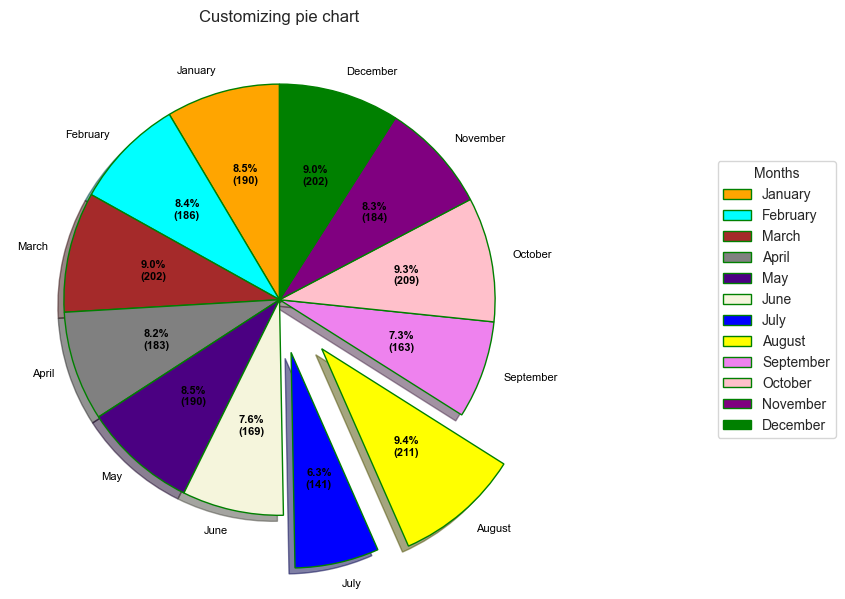

In [121]:
# Creating dataset
months = ["January","February","March","April","May","June","July","August","September","October","November","December"]

data = [191,187,202,184,191,170,141,211,164,209,185,202]


# Creating explode data
explode = (0.0, 0.0, 0.0, 0.0, 0.0, 0.0,0.25,0.3,0.0,0.0,0.0,0.0)

# Creating color parameters
colors = ( "orange", "cyan", "brown","grey", "indigo", "beige","blue","yellow","violet","pink","purple","green")

# Wedge properties
wp = { 'linewidth' : 1, 'edgecolor' : "green" }

# Creating autocpt arguments
def func(pct, allvalues):
    absolute = int(pct / 100.*np.sum(allvalues))
    return "{:.1f}%\n({:d})".format(pct, absolute)

# Creating plot
fig, ax = plt.subplots(figsize =(10, 7))
wedges, texts, autotexts = ax.pie(data,
autopct = lambda pct: func(pct, data),
explode = explode,
labels = months,
shadow = True,
colors = colors,
startangle = 90,
wedgeprops = wp,
textprops = dict(color ="black"))

# Adding legend
ax.legend(wedges, months,
title ="Months",
loc ="center left",
bbox_to_anchor =(1.3, 0, 0.5, 1))

plt.setp(autotexts, size = 8, weight ="bold")
ax.set_title("Customizing pie chart")

# show plot
plt.show()


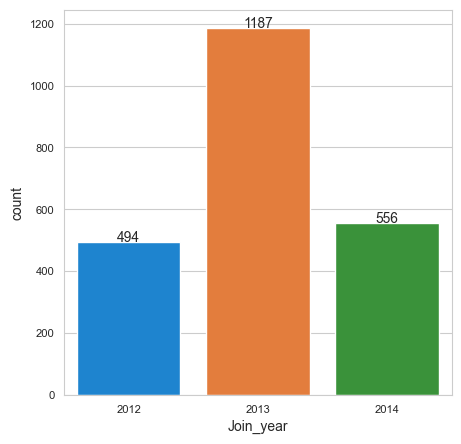

In [118]:
# Lets Display Count on top of countplot

fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Join_year', data=new_df)
graph.set_xticklabels(graph.get_xticklabels())
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

<AxesSubplot:xlabel='Income', ylabel='Count'>

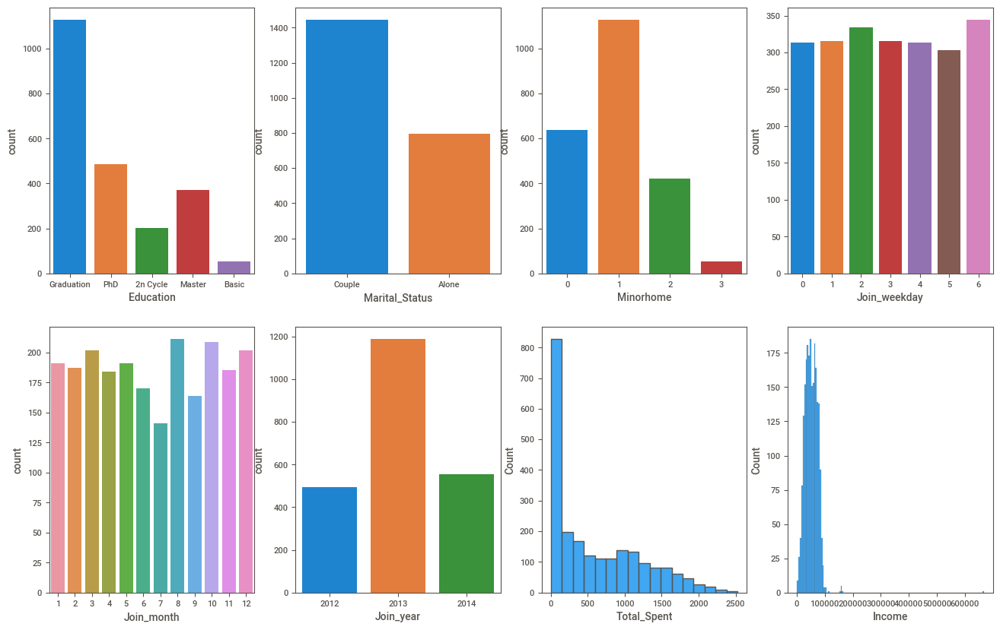

In [59]:
# Combined univariate analysis of each variables
fig,axes = plt.subplots(2,4, figsize=(16,10))
sns.countplot('Education',data=new_df,ax=axes[0,0])
sns.countplot('Marital_Status',data=new_df,ax=axes[0,1])
sns.countplot('Minorhome',data=new_df,ax=axes[0,2])
sns.countplot('Join_weekday',data=new_df,ax=axes[0,3])
sns.countplot('Join_month',data=new_df,ax=axes[1,0])
sns.countplot('Join_year',data=new_df,ax=axes[1,1])

#sns.distplot(df_train['Fare'], kde=True,ax=axes[1,2])
sns.histplot(data=new_df,x="Total_Spent",ax=axes[1,2])
sns.histplot(data=new_df,x="Income",ax=axes[1,3] )


### Bivariate Analysis

We perform bi-variate analysis with 2 variables for any combination of categorical and continuous variables.
The combination can be: Categorical & Categorical, Categorical & Continuous and Continuous & Continuous.

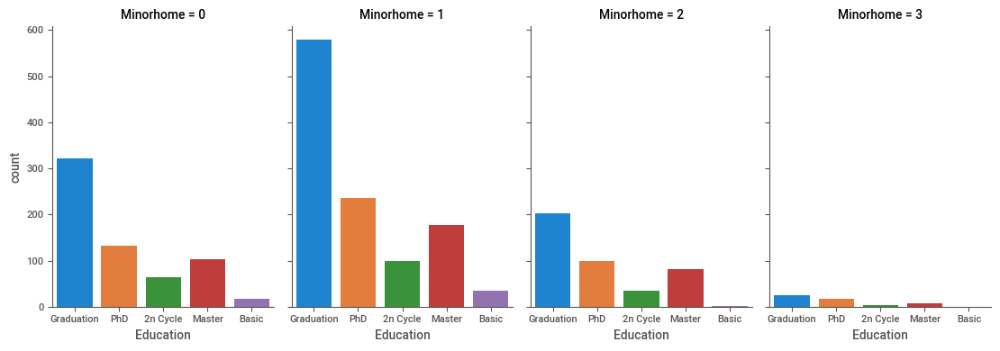

In [67]:
# Lets more elaborate customer behaviour with Education and Income --> use catplot or countplot
'''
fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Education',hue="Minorhome",data=new_df)
graph.set_xticklabels(graph.get_xticklabels(),rotation=90)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")
'''

sns.catplot(x="Education",col="Minorhome",data=new_df, kind="count",height=4, aspect =.7)

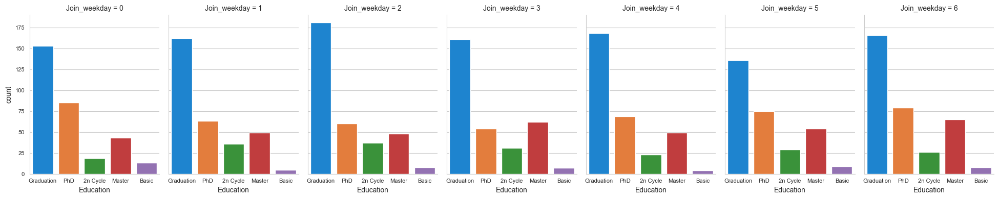

In [116]:
# Lets more elaborate customer behaviour with Education and Income --> use catplot or countplot

sns.catplot(x="Education",col="Join_weekday",data=new_df, kind="count",height=4, aspect =.7)

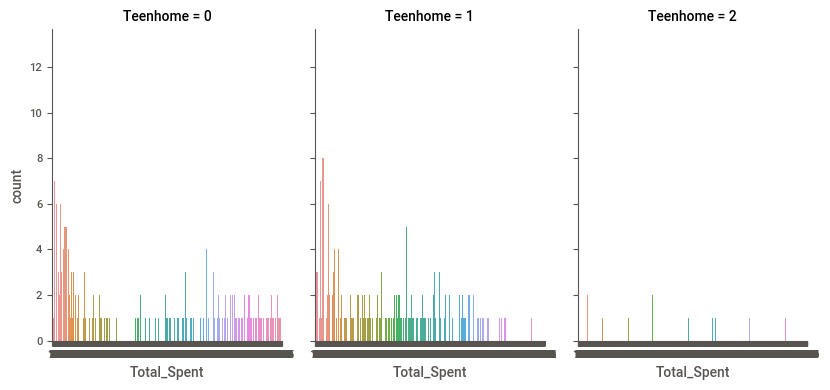

In [72]:
# Lets more elaborate customer behaviour with Teenhome and Total_Spent --> use catplot or countplot
'''
fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Total_Spent',hue="Teenhome",data=new_df)
graph.set_xticklabels(graph.get_xticklabels(),rotation=90)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")
'''

sns.catplot(x="Total_Spent",col="Teenhome",data=new_df, kind="count",height=4, aspect =.7)

### Multivariate Analysis

We perform multivariate analysis with more than 2 variables for any combination of categorical and continuous variables.

The combination can be: 

Categorical & Categorical, Categorical & Continuous and Continuous & Continuous.

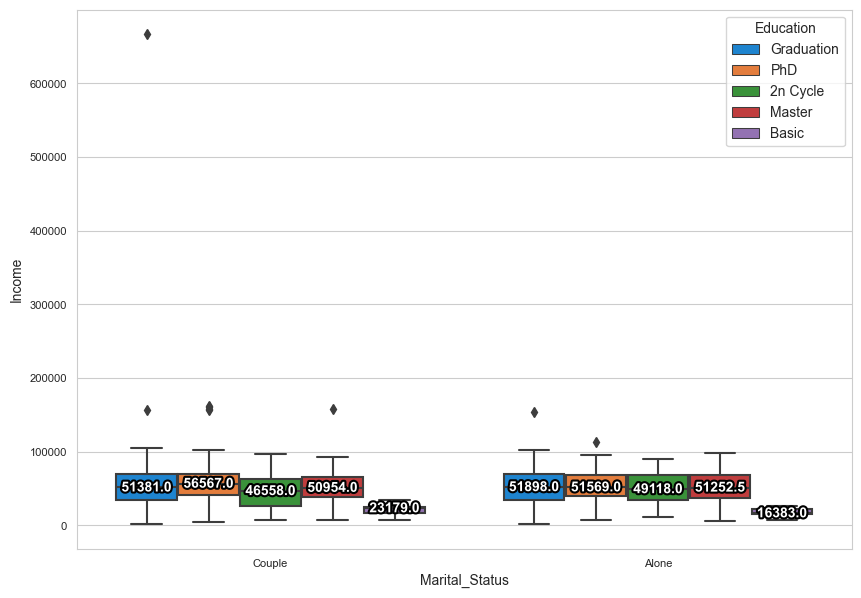

In [111]:
fig, ax1 = plt.subplots(figsize=(10,7))

def main():
    sns.set_style("whitegrid")
    tips = new_df
    # optionally disable fliers
    showfliers = True
    # plot data and create median labels
    box_plot = sns.boxplot(ax=ax1, x='Marital_Status', y='Income', hue='Education', data=new_df,
                           showfliers=showfliers)
    create_median_labels(box_plot.axes, showfliers)
    plt.show()


def create_median_labels(ax, has_fliers):
    lines = ax.get_lines()
    # depending on fliers, toggle between 5 and 6 lines per box
    lines_per_box = 5 + int(has_fliers)
    # iterate directly over all median lines, with an interval of lines_per_box
    # this enables labeling of grouped data without relying on tick positions
    for median_line in lines[4:len(lines):lines_per_box]:
        # get center of median line
        mean_x = sum(median_line._x) / len(median_line._x)
        mean_y = sum(median_line._y) / len(median_line._y)
        # print text to center coordinates
        text = ax.text(mean_x, mean_y, f'{mean_y:.1f}',
                       ha='center', va='center',
                       fontweight='bold', size=10, color='white')
        # create small black border around white text
        # for better readability on multi-colored boxes
        text.set_path_effects([
            path_effects.Stroke(linewidth=3, foreground='black'),
            path_effects.Normal(),
        ])


if __name__ == '__main__':
    main()

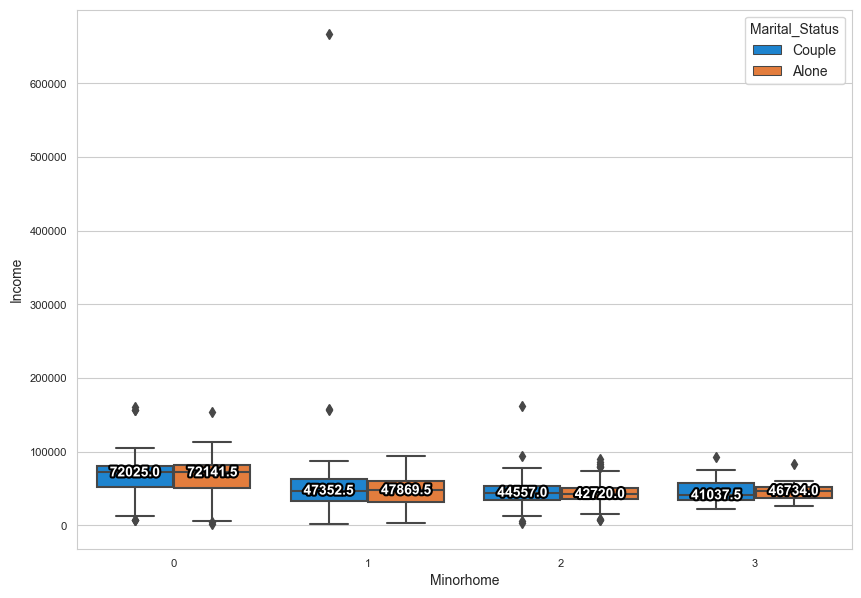

In [112]:
fig, ax1 = plt.subplots(figsize=(10,7))

def main():
    sns.set_style("whitegrid")
    tips = new_df
    # optionally disable fliers
    showfliers = True
    # plot data and create median labels
    box_plot = sns.boxplot(ax=ax1, x='Minorhome', y='Income', hue='Marital_Status', data=new_df,
                           showfliers=showfliers)
    create_median_labels(box_plot.axes, showfliers)
    plt.show()


def create_median_labels(ax, has_fliers):
    lines = ax.get_lines()
    # depending on fliers, toggle between 5 and 6 lines per box
    lines_per_box = 5 + int(has_fliers)
    # iterate directly over all median lines, with an interval of lines_per_box
    # this enables labeling of grouped data without relying on tick positions
    for median_line in lines[4:len(lines):lines_per_box]:
        # get center of median line
        mean_x = sum(median_line._x) / len(median_line._x)
        mean_y = sum(median_line._y) / len(median_line._y)
        # print text to center coordinates
        text = ax.text(mean_x, mean_y, f'{mean_y:.1f}',
                       ha='center', va='center',
                       fontweight='bold', size=10, color='white')
        # create small black border around white text
        # for better readability on multi-colored boxes
        text.set_path_effects([
            path_effects.Stroke(linewidth=3, foreground='black'),
            path_effects.Normal(),
        ])


if __name__ == '__main__':
    main()

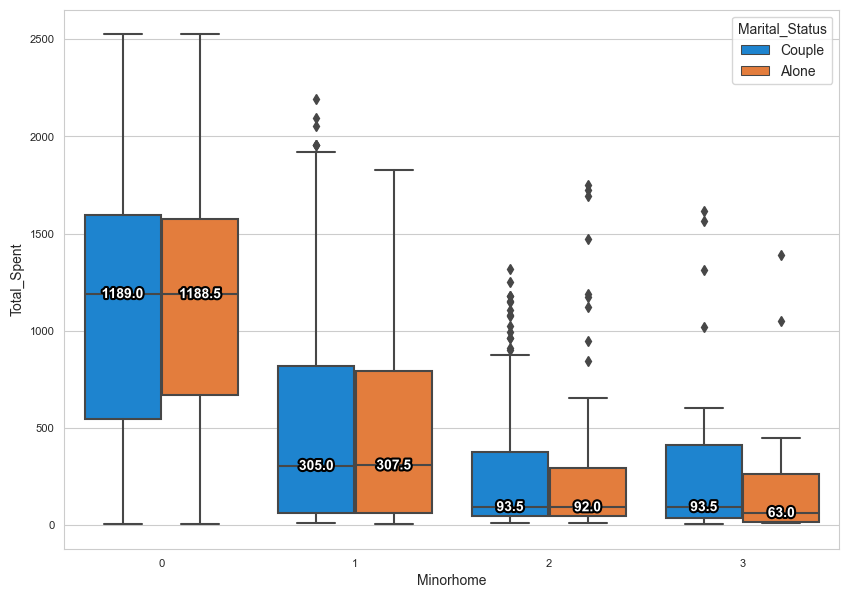

In [113]:
fig, ax1 = plt.subplots(figsize=(10,7))

def main():
    sns.set_style("whitegrid")
    tips = new_df
    # optionally disable fliers
    showfliers = True
    # plot data and create median labels
    box_plot = sns.boxplot(ax=ax1, x='Minorhome', y='Total_Spent', hue='Marital_Status', data=new_df,
                           showfliers=showfliers)
    create_median_labels(box_plot.axes, showfliers)
    plt.show()


def create_median_labels(ax, has_fliers):
    lines = ax.get_lines()
    # depending on fliers, toggle between 5 and 6 lines per box
    lines_per_box = 5 + int(has_fliers)
    # iterate directly over all median lines, with an interval of lines_per_box
    # this enables labeling of grouped data without relying on tick positions
    for median_line in lines[4:len(lines):lines_per_box]:
        # get center of median line
        mean_x = sum(median_line._x) / len(median_line._x)
        mean_y = sum(median_line._y) / len(median_line._y)
        # print text to center coordinates
        text = ax.text(mean_x, mean_y, f'{mean_y:.1f}',
                       ha='center', va='center',
                       fontweight='bold', size=10, color='white')
        # create small black border around white text
        # for better readability on multi-colored boxes
        text.set_path_effects([
            path_effects.Stroke(linewidth=3, foreground='black'),
            path_effects.Normal(),
        ])


if __name__ == '__main__':
    main()

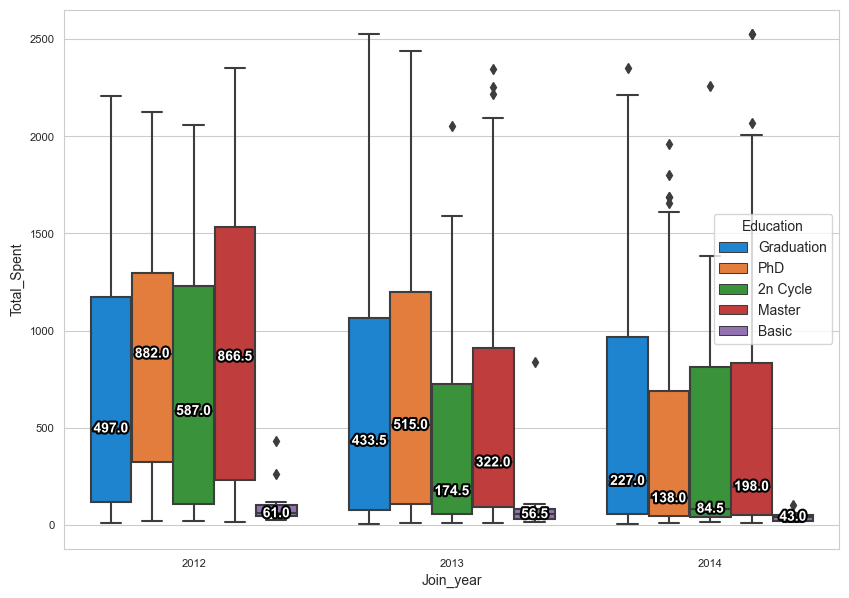

In [119]:
fig, ax1 = plt.subplots(figsize=(10,7))

def main():
    sns.set_style("whitegrid")
    tips = new_df
    # optionally disable fliers
    showfliers = True
    # plot data and create median labels
    box_plot = sns.boxplot(ax=ax1, x='Join_year', y='Total_Spent', hue='Education', data=new_df,
                           showfliers=showfliers)
    create_median_labels(box_plot.axes, showfliers)
    plt.show()


def create_median_labels(ax, has_fliers):
    lines = ax.get_lines()
    # depending on fliers, toggle between 5 and 6 lines per box
    lines_per_box = 5 + int(has_fliers)
    # iterate directly over all median lines, with an interval of lines_per_box
    # this enables labeling of grouped data without relying on tick positions
    for median_line in lines[4:len(lines):lines_per_box]:
        # get center of median line
        mean_x = sum(median_line._x) / len(median_line._x)
        mean_y = sum(median_line._y) / len(median_line._y)
        # print text to center coordinates
        text = ax.text(mean_x, mean_y, f'{mean_y:.1f}',
                       ha='center', va='center',
                       fontweight='bold', size=10, color='white')
        # create small black border around white text
        # for better readability on multi-colored boxes
        text.set_path_effects([
            path_effects.Stroke(linewidth=3, foreground='black'),
            path_effects.Normal(),
        ])


if __name__ == '__main__':
    main()

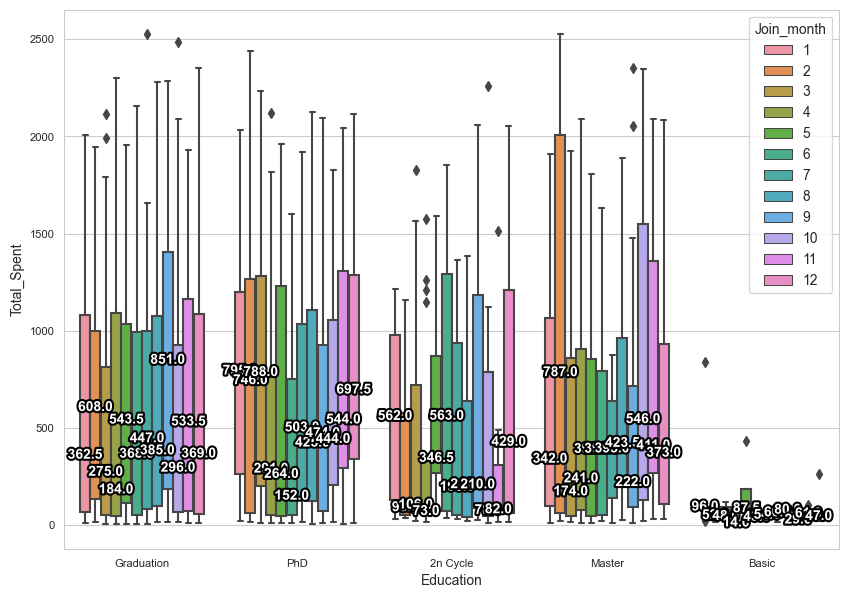

In [120]:
fig, ax1 = plt.subplots(figsize=(10,7))

def main():
    sns.set_style("whitegrid")
    tips = new_df
    # optionally disable fliers
    showfliers = True
    # plot data and create median labels
    box_plot = sns.boxplot(ax=ax1, x='Education', y='Total_Spent', hue='Join_month', data=new_df,
                           showfliers=showfliers)
    create_median_labels(box_plot.axes, showfliers)
    plt.show()


def create_median_labels(ax, has_fliers):
    lines = ax.get_lines()
    # depending on fliers, toggle between 5 and 6 lines per box
    lines_per_box = 5 + int(has_fliers)
    # iterate directly over all median lines, with an interval of lines_per_box
    # this enables labeling of grouped data without relying on tick positions
    for median_line in lines[4:len(lines):lines_per_box]:
        # get center of median line
        mean_x = sum(median_line._x) / len(median_line._x)
        mean_y = sum(median_line._y) / len(median_line._y)
        # print text to center coordinates
        text = ax.text(mean_x, mean_y, f'{mean_y:.1f}',
                       ha='center', va='center',
                       fontweight='bold', size=10, color='white')
        # create small black border around white text
        # for better readability on multi-colored boxes
        text.set_path_effects([
            path_effects.Stroke(linewidth=3, foreground='black'),
            path_effects.Normal(),
        ])


if __name__ == '__main__':
    main()